In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import math
from sklearn import preprocessing
from sklearn import decomposition
import plotly.express as px
import statsmodels.formula.api
import scipy.stats
import statsmodels.formula.api as smf
import statsmodels.api as sm
import scipy
import sys
if not sys.warnoptions:
    import warnings
    warnings.simplefilter("ignore")
        
        
result = pd.read_csv('result_clean')
result = result.rename(columns={'nutrition-score-fr_100g' : 'nutrition_score_100g'})
result = result.rename(columns={'saturated-fat_100g' : 'saturated_fat_100g'})

## Répartition des produits par nutri-grade

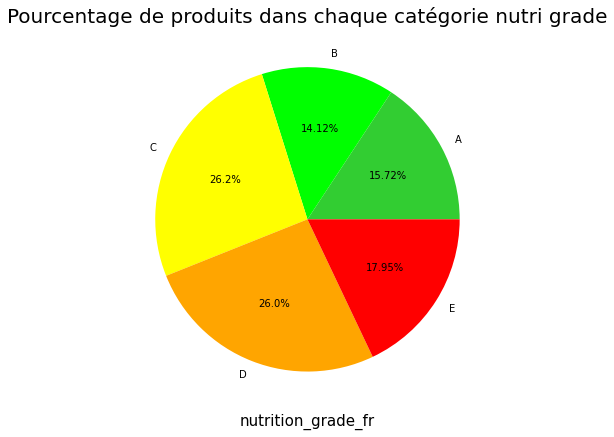

In [2]:
colors = ['limegreen', 'lime', 'yellow', 'orange', 'red']
labels = ['A', 'B', 'C', 'D', 'E']
result['nutrition_grade_fr'].value_counts(normalize=True).sort_index().plot(kind='pie', colors=colors, labels=labels,autopct = lambda x: str(round(x,2)) + '%', figsize=(7,7))
plt.title("Pourcentage de produits dans chaque catégorie nutri grade", fontsize='20')
plt.ylabel('')
plt.xlabel("nutrition_grade_fr", fontsize='15')
plt.xticks(rotation=0)
plt.show()

La réprésentations des produits est assez équilibrés

## Quantité de nutriments en fonction du nutri-score

In [3]:
apport_nutrition = []
for i in result :
    if '_100g' in i :
        apport_nutrition.append(i)

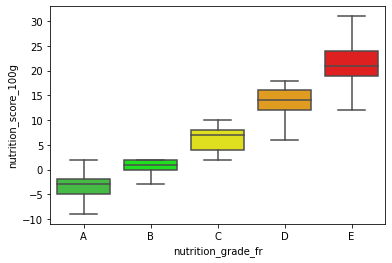

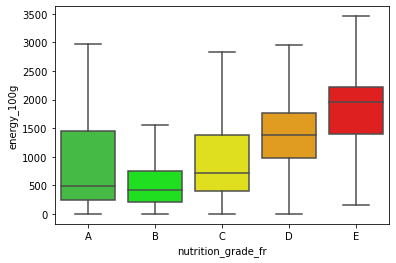

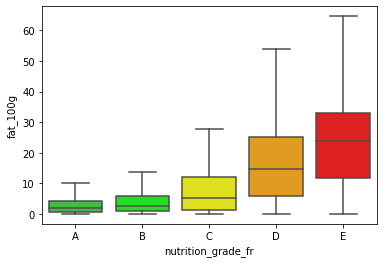

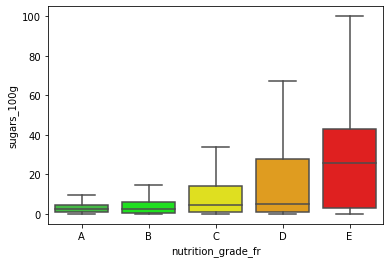

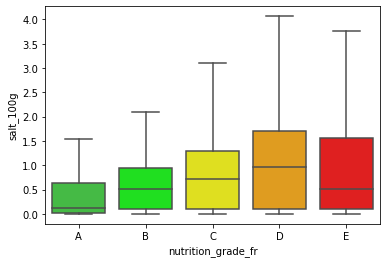

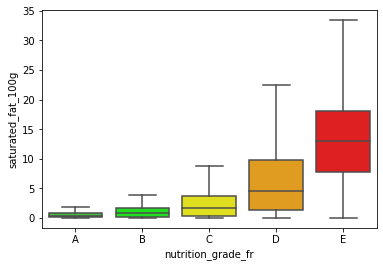

In [4]:
box_plot = result[apport_nutrition]
order = sorted(result["nutrition_grade_fr"].dropna().unique())
labels = ['A', 'B', 'C', 'D', 'E']
y_pos = np.arange(len(labels))
for macro_nutri in apport_nutrition :
    sns.boxplot(data=box_plot, x=result['nutrition_grade_fr'], y=macro_nutri, order=order, showfliers=False, palette={'a':'limegreen', 'b':'lime', 'c':'yellow', 'd':'orange', 'e':'red'})
    plt.xticks(y_pos, labels)
    plt.show()

On peut considérer sur nos produits, que plus il y a de sel, de sucre ou de gras, plus le nutri-score est mauvais 


Selon l'OMS :  
- recommande une consommation de sel inférieure à 5 g par jour (soit l’équivalent d’une cuillère à café par jour) afin de prévenir les maladies cardiovasculaires.


- En ce qui concerne le sucre, et pour un adulte avec un apport moyen, cela représente 50 g/jour.


- Les lipides, constitués d’unités de base appelées « acides gras » doivent représenter 35 à 40% de l’apport énergétique ingéré chaque jour soit entre 97 et 111 g pour un adulte.


- La part des acides gras saturés ne doit pas dépasser 26 g.

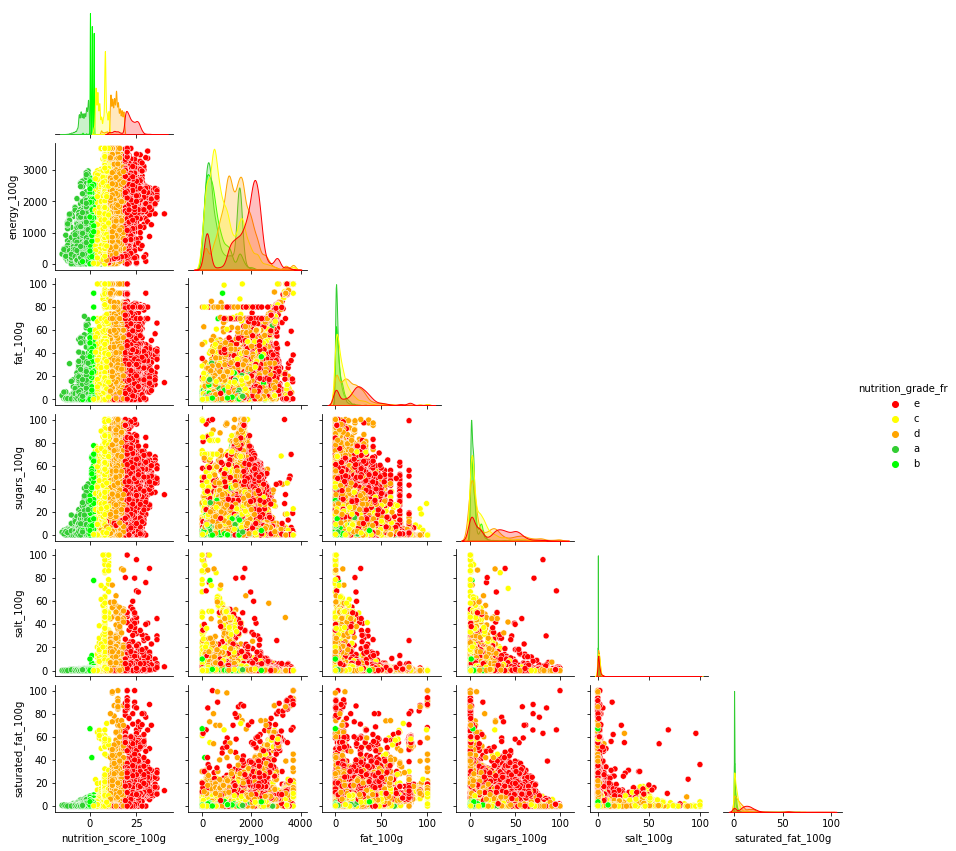

In [5]:
ax = sns.pairplot(data=result, vars=apport_nutrition, hue='nutrition_grade_fr', palette = {'a':"limegreen", 'b':"lime", 'c':"yellow", 'd':"orange", 'e':"red"}, corner=True, height=2)
plt.show()

- On peut remarquer un certain regroupement entre produits du même nutri-score
- Ce graphique permet d'avoir une estimation de la qualité des produits en fonction de son nutri grade

## Matrice des corrélations

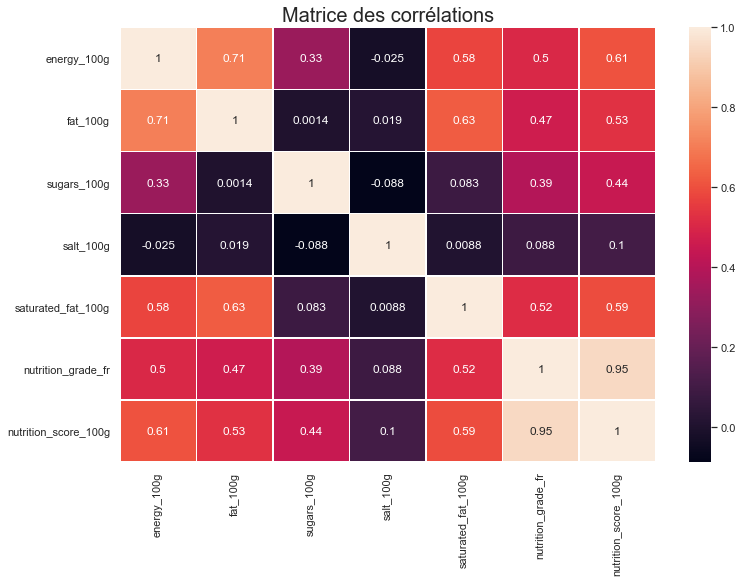

In [6]:
result_apport = result[['energy_100g', 'fat_100g', 'sugars_100g', 'salt_100g', 'saturated_fat_100g', 'nutrition_grade_fr', 'nutrition_score_100g']]
result_apport['nutrition_grade_fr'] = result_apport['nutrition_grade_fr'].map({'a':1, 'b':2, 'c':3, 'd':4, 'e':5})

sns.set_theme()

fit = preprocessing.StandardScaler().fit_transform(result_apport)
fit = pd.DataFrame(fit, columns=result_apport.columns)
# Draw a heatmap with the numeric values in each cell
fit_corr = fit.corr()
f, ax = plt.subplots(figsize=(12, 8))
sns.heatmap(fit_corr, annot=True, linewidths=.5, ax=ax)
plt.title('Matrice des corrélations', fontsize='20')
plt.show()

## vérification d'une corrélation entre variable quantitative/qualitative

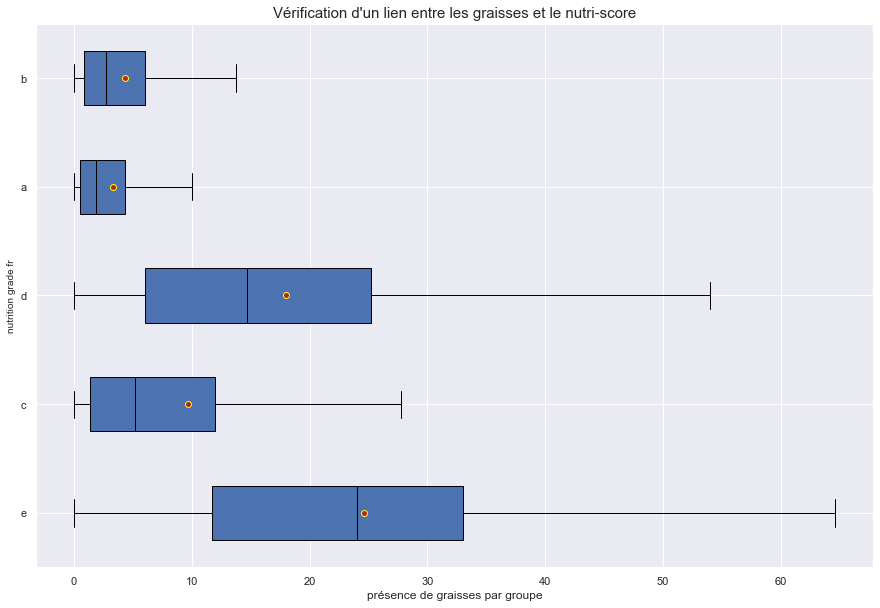

In [7]:
corr = result[['nutrition_grade_fr', 'fat_100g']]

X = "nutrition_grade_fr" # qualitative
Y = "fat_100g" # quantitative

modalites = corr[X].unique()
groupes = []
for m in modalites:
    groupes.append(corr[corr[X]==m][Y])

# Propriétés graphiques (pas très importantes)    
medianprops = {'color':"black"}
meanprops = {'marker':'o', 'markeredgecolor':'yellow',
            'markerfacecolor':'firebrick'}
 
fig, ax = plt.subplots(figsize= (15,10))
  
plt.boxplot(groupes, labels=modalites, showfliers=False, medianprops=medianprops, 
            vert=False, patch_artist=True, showmeans=True, meanprops=meanprops)
ax.set_ylabel('nutrition grade fr', fontsize=10)
ax.set_xlabel('présence de graisses par groupe')
plt.title('Vérification d\'un lien entre les graisses et le nutri-score', fontsize=15)
plt.show()

## Test de shapiro sur le nutri-score A


Sachant que l'hypothèse nulle est que la population est normalement distribuée,

- si la p-value est inférieure à un niveau alpha choisi (par exemple 0.05), alors l'hypothèse nulle est rejetée (i.e. il est improbable d'obtenir de telles données en supposant qu'elles soient normalement distribuées).

- si la p-value est supérieure au niveau alpha choisi (par exemple 0.05), alors on ne doit pas rejeter l'hypothèse nulle. La valeur de la p-value alors obtenue ne présuppose en rien de la nature de la distribution des données.

In [8]:
shapiroFA = result[['nutrition_grade_fr', 'fat_100g']]
shapiroSFA = result[['nutrition_grade_fr', 'saturated_fat_100g']]
shapiroSA = result[['nutrition_grade_fr', 'sugars_100g']]
shapiroSALT = result[['nutrition_grade_fr', 'salt_100g']]
shapiroEA = result[['nutrition_grade_fr', 'energy_100g']]

n,random_state = 1000,1
shapiroFA = shapiroFA[shapiroFA.nutrition_grade_fr == 'a']
shapiroSFA = shapiroSFA[shapiroSFA.nutrition_grade_fr == 'a']
shapiroSA = shapiroSA[shapiroSA.nutrition_grade_fr == 'a']
shapiroSALT = shapiroSALT[shapiroSALT.nutrition_grade_fr == 'a']
shapiroEA = shapiroEA[shapiroEA.nutrition_grade_fr == 'a']

print('Pour les graisses, le test donne :',scipy.stats.shapiro(list(shapiroFA.sample(n,random_state=random_state).fat_100g)))
print('Pour les graisses saturées, le test donne :', scipy.stats.shapiro(list(shapiroSFA.sample(n,random_state=random_state).saturated_fat_100g)))
print('Pour les sucres, le test donne :', scipy.stats.shapiro(list(shapiroSA.sample(n,random_state=random_state).sugars_100g)))
print('Pour le sel, les test donne :', scipy.stats.shapiro(list(shapiroSALT.sample(n,random_state=random_state).salt_100g)))
print('Pour l\'energy, le test donne :', scipy.stats.shapiro(list(shapiroEA.sample(n,random_state=random_state).energy_100g)))

Pour les graisses, le test donne : ShapiroResult(statistic=0.6052291393280029, pvalue=8.407790785948902e-43)
Pour les graisses saturées, le test donne : ShapiroResult(statistic=0.7290295362472534, pvalue=1.9774935594038213e-37)
Pour les sucres, le test donne : ShapiroResult(statistic=0.7420830726623535, pvalue=9.398335263424726e-37)
Pour le sel, les test donne : ShapiroResult(statistic=0.8064557909965515, pvalue=6.0527930631167354e-33)
Pour l'energy, le test donne : ShapiroResult(statistic=0.8519412279129028, pvalue=1.377344146982776e-29)


<AxesSubplot:>

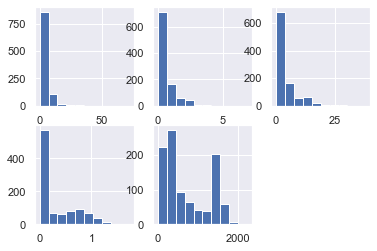

In [9]:
plt.subplot(231)
shapiroFA.sample(n,random_state=random_state).fat_100g.hist()
plt.subplot(232)
shapiroSFA.sample(n,random_state=random_state).saturated_fat_100g.hist()
plt.subplot(233)
shapiroSA.sample(n,random_state=random_state).sugars_100g.hist()
plt.subplot(234)
shapiroSALT.sample(n,random_state=random_state).salt_100g.hist()
plt.subplot(235)
shapiroEA.sample(n,random_state=random_state).energy_100g.hist()

## Test de shapiro sur le nutri-score B

In [10]:
shapiroFB = result[['nutrition_grade_fr', 'fat_100g']]
shapiroSFB = result[['nutrition_grade_fr', 'saturated_fat_100g']]
shapiroSB = result[['nutrition_grade_fr', 'sugars_100g']]
shapiroSBLT = result[['nutrition_grade_fr', 'salt_100g']]
shapiroEB = result[['nutrition_grade_fr', 'energy_100g']]

n,random_state = 1000,1
shapiroFB = shapiroFB[shapiroFB.nutrition_grade_fr == 'b']
shapiroSFB = shapiroSFB[shapiroSFB.nutrition_grade_fr == 'b']
shapiroSB = shapiroSB[shapiroSB.nutrition_grade_fr == 'b']
shapiroSBLT = shapiroSBLT[shapiroSBLT.nutrition_grade_fr == 'b']
shapiroEB = shapiroEB[shapiroEB.nutrition_grade_fr == 'b']

print('Pour les graisses, le test donne :',scipy.stats.shapiro(list(shapiroFB.sample(n,random_state=random_state).fat_100g)))
print('Pour les graisses saturées, le test donne :', scipy.stats.shapiro(list(shapiroSFB.sample(n,random_state=random_state).saturated_fat_100g)))
print('Pour les sucres, le test donne :', scipy.stats.shapiro(list(shapiroSB.sample(n,random_state=random_state).sugars_100g)))
print('Pour le sel, les test donne :', scipy.stats.shapiro(list(shapiroSBLT.sample(n,random_state=random_state).salt_100g)))
print('Pour l\'energy, le test donne :', scipy.stats.shapiro(list(shapiroEB.sample(n,random_state=random_state).energy_100g)))

Pour les graisses, le test donne : ShapiroResult(statistic=0.7735762596130371, pvalue=5.341015277276383e-35)
Pour les graisses saturées, le test donne : ShapiroResult(statistic=0.8282948136329651, pvalue=2.0218272437250584e-31)
Pour les sucres, le test donne : ShapiroResult(statistic=0.6775969862937927, pvalue=7.277012990161991e-40)
Pour le sel, les test donne : ShapiroResult(statistic=0.8836231827735901, pvalue=9.87193633117196e-27)
Pour l'energy, le test donne : ShapiroResult(statistic=0.87347811460495, pvalue=1.0484856024846415e-27)


<AxesSubplot:>

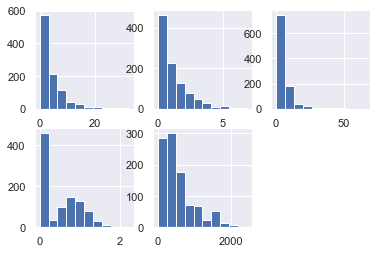

In [11]:
plt.subplot(231)
shapiroFB.sample(n,random_state=random_state).fat_100g.hist()
plt.subplot(232)
shapiroSFB.sample(n,random_state=random_state).saturated_fat_100g.hist()
plt.subplot(233)
shapiroSB.sample(n,random_state=random_state).sugars_100g.hist()
plt.subplot(234)
shapiroSBLT.sample(n,random_state=random_state).salt_100g.hist()
plt.subplot(235)
shapiroEB.sample(n,random_state=random_state).energy_100g.hist()

## Test de shapiro sur le nutri-score C

In [12]:
shapiroFC = result[['nutrition_grade_fr', 'fat_100g']]
shapiroSFC = result[['nutrition_grade_fr', 'saturated_fat_100g']]
shapiroSC = result[['nutrition_grade_fr', 'sugars_100g']]
shapiroSCLT = result[['nutrition_grade_fr', 'salt_100g']]
shapiroEC = result[['nutrition_grade_fr', 'energy_100g']]

n,random_state = 1000,1
shapiroFC = shapiroFC[shapiroFC.nutrition_grade_fr == 'c']
shapiroSFC = shapiroSFC[shapiroSFC.nutrition_grade_fr == 'c']
shapiroSC = shapiroSC[shapiroSC.nutrition_grade_fr == 'c']
shapiroSCLT = shapiroSCLT[shapiroSCLT.nutrition_grade_fr == 'c']
shapiroEC = shapiroEC[shapiroEC.nutrition_grade_fr == 'c']

print('Pour les graisses, le test donne :',scipy.stats.shapiro(list(shapiroFC.sample(n,random_state=random_state).fat_100g)))
print('Pour les graisses saturées, le test donne :', scipy.stats.shapiro(list(shapiroSFC.sample(n,random_state=random_state).saturated_fat_100g)))
print('Pour les sucres, le test donne :', scipy.stats.shapiro(list(shapiroSC.sample(n,random_state=random_state).sugars_100g)))
print('Pour le sel, les test donne :', scipy.stats.shapiro(list(shapiroSCLT.sample(n,random_state=random_state).salt_100g)))
print('Pour l\'energy, le test donne :', scipy.stats.shapiro(list(shapiroEC.sample(n,random_state=random_state).energy_100g)))

Pour les graisses, le test donne : ShapiroResult(statistic=0.6354638934135437, pvalue=1.2400090110810306e-41)
Pour les graisses saturées, le test donne : ShapiroResult(statistic=0.5603264570236206, pvalue=2.1019476964872256e-44)
Pour les sucres, le test donne : ShapiroResult(statistic=0.6873608231544495, pvalue=1.9884046858183787e-39)
Pour le sel, les test donne : ShapiroResult(statistic=0.17101669311523438, pvalue=0.0)
Pour l'energy, le test donne : ShapiroResult(statistic=0.9044127464294434, pvalue=1.6385799640894959e-24)


<AxesSubplot:>

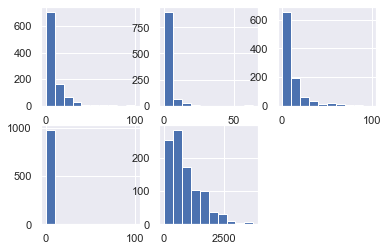

In [13]:
plt.subplot(231)
shapiroFC.sample(n,random_state=random_state).fat_100g.hist()
plt.subplot(232)
shapiroSFC.sample(n,random_state=random_state).saturated_fat_100g.hist()
plt.subplot(233)
shapiroSC.sample(n,random_state=random_state).sugars_100g.hist()
plt.subplot(234)
shapiroSCLT.sample(n,random_state=random_state).salt_100g.hist()
plt.subplot(235)
shapiroEC.sample(n,random_state=random_state).energy_100g.hist()

## Test de shapiro sur le nutri-score D

In [14]:
shapiroFD = result[['nutrition_grade_fr', 'fat_100g']]
shapiroSFD = result[['nutrition_grade_fr', 'saturated_fat_100g']]
shapiroSD = result[['nutrition_grade_fr', 'sugars_100g']]
shapiroSDLT = result[['nutrition_grade_fr', 'salt_100g']]
shapiroED = result[['nutrition_grade_fr', 'energy_100g']]

n,random_state = 1000,1
shapiroFD = shapiroFD[shapiroFD.nutrition_grade_fr == 'd']
shapiroSFD = shapiroSFD[shapiroSFD.nutrition_grade_fr == 'd']
shapiroSD = shapiroSD[shapiroSD.nutrition_grade_fr == 'd']
shapiroSDLT = shapiroSDLT[shapiroSDLT.nutrition_grade_fr == 'd']
shapiroED = shapiroED[shapiroED.nutrition_grade_fr == 'd']

print('Pour les graisses, le test donne :',scipy.stats.shapiro(list(shapiroFD.sample(n,random_state=random_state).fat_100g)))
print('Pour les graisses saturées, le test donne :', scipy.stats.shapiro(list(shapiroSFD.sample(n,random_state=random_state).saturated_fat_100g)))
print('Pour les sucres, le test donne :', scipy.stats.shapiro(list(shapiroSD.sample(n,random_state=random_state).sugars_100g)))
print('Pour le sel, les test donne :', scipy.stats.shapiro(list(shapiroSDLT.sample(n,random_state=random_state).salt_100g)))
print('Pour l\'energy, le test donne :', scipy.stats.shapiro(list(shapiroED.sample(n,random_state=random_state).energy_100g)))

Pour les graisses, le test donne : ShapiroResult(statistic=0.8226183652877808, pvalue=7.862370372607673e-32)
Pour les graisses saturées, le test donne : ShapiroResult(statistic=0.8258248567581177, pvalue=1.3364795952111857e-31)
Pour les sucres, le test donne : ShapiroResult(statistic=0.7532708048820496, pvalue=3.763271911000071e-36)
Pour le sel, les test donne : ShapiroResult(statistic=0.3995511531829834, pvalue=0.0)
Pour l'energy, le test donne : ShapiroResult(statistic=0.9777191281318665, pvalue=2.9817995295111643e-11)


<AxesSubplot:>

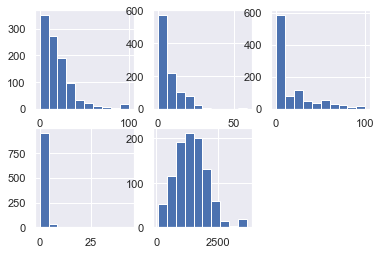

In [15]:
plt.subplot(231)
shapiroFD.sample(n,random_state=random_state).fat_100g.hist()
plt.subplot(232)
shapiroSFD.sample(n,random_state=random_state).saturated_fat_100g.hist()
plt.subplot(233)
shapiroSD.sample(n,random_state=random_state).sugars_100g.hist()
plt.subplot(234)
shapiroSDLT.sample(n,random_state=random_state).salt_100g.hist()
plt.subplot(235)
shapiroED.sample(n,random_state=random_state).energy_100g.hist()

## Test de shapiro sur le nutri-score E

In [16]:
shapiroFE = result[['nutrition_grade_fr', 'fat_100g']]
shapiroSFE = result[['nutrition_grade_fr', 'saturated_fat_100g']]
shapiroSE = result[['nutrition_grade_fr', 'sugars_100g']]
shapiroSELT = result[['nutrition_grade_fr', 'salt_100g']]
shapiroEE = result[['nutrition_grade_fr', 'energy_100g']]

n,random_state = 1000,1
shapiroFE = shapiroFE[shapiroFE.nutrition_grade_fr == 'e']
shapiroSFE = shapiroSFE[shapiroSFE.nutrition_grade_fr == 'e']
shapiroSE = shapiroSE[shapiroSE.nutrition_grade_fr == 'e']
shapiroSELT = shapiroSELT[shapiroSELT.nutrition_grade_fr == 'e']
shapiroEE = shapiroEE[shapiroEE.nutrition_grade_fr == 'e']

print('Pour les graisses, le test donne :',scipy.stats.shapiro(list(shapiroFE.sample(n,random_state=random_state).fat_100g)))
print('Pour les graisses saturées, le test donne :', scipy.stats.shapiro(list(shapiroSFE.sample(n,random_state=random_state).saturated_fat_100g)))
print('Pour les sucres, le test donne :', scipy.stats.shapiro(list(shapiroSE.sample(n,random_state=random_state).sugars_100g)))
print('Pour le sel, les test donne :', scipy.stats.shapiro(list(shapiroSELT.sample(n,random_state=random_state).salt_100g)))
print('Pour l\'energy, le test donne :', scipy.stats.shapiro(list(shapiroEE.sample(n,random_state=random_state).energy_100g)))

Pour les graisses, le test donne : ShapiroResult(statistic=0.9069191217422485, pvalue=3.209051846989699e-24)
Pour les graisses saturées, le test donne : ShapiroResult(statistic=0.8056416511535645, pvalue=5.343846910006044e-33)
Pour les sucres, le test donne : ShapiroResult(statistic=0.9212496280670166, pvalue=1.997206359184604e-22)
Pour le sel, les test donne : ShapiroResult(statistic=0.23121625185012817, pvalue=0.0)
Pour l'energy, le test donne : ShapiroResult(statistic=0.9109175205230713, pvalue=9.653147324504771e-24)


<AxesSubplot:>

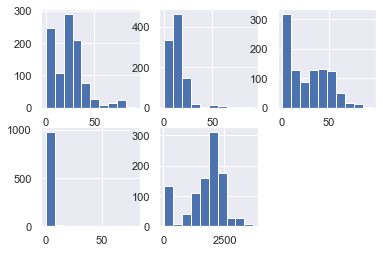

In [17]:
plt.subplot(231)
shapiroFE.sample(n,random_state=random_state).fat_100g.hist()
plt.subplot(232)
shapiroSFE.sample(n,random_state=random_state).saturated_fat_100g.hist()
plt.subplot(233)
shapiroSE.sample(n,random_state=random_state).sugars_100g.hist()
plt.subplot(234)
shapiroSELT.sample(n,random_state=random_state).salt_100g.hist()
plt.subplot(235)
shapiroEE.sample(n,random_state=random_state).energy_100g.hist()

Aucun groupe ne suit une loi normal, pour savoir si nos groupes sont différents, un test non-paramétrique est à affectuer

## Test de Krustal Wallis

Le test de Kruskal-Wallis, aussi appelé ANOVA unidirectionnelle sur rangs est une méthode non paramétrique utilisée pour tester si des échantillons trouvent leur origine dans la même distribution.

In [18]:
from scipy import stats
print('Pour les graisses: ',stats.kruskal(shapiroFA.fat_100g, shapiroFB.fat_100g, shapiroFC.fat_100g, shapiroFD.fat_100g, shapiroFE.fat_100g))
print('Pour les graisses saturées: ',stats.kruskal(shapiroSFA.saturated_fat_100g, shapiroSFB.saturated_fat_100g, shapiroSFC.saturated_fat_100g, shapiroSFD.saturated_fat_100g, shapiroSFE.saturated_fat_100g))
print('Pour les sucres: ',stats.kruskal(shapiroSA.sugars_100g, shapiroSB.sugars_100g, shapiroSC.sugars_100g, shapiroSD.sugars_100g, shapiroSE.sugars_100g))
print('Pour le sel: ',stats.kruskal(shapiroSALT.salt_100g, shapiroSBLT.salt_100g, shapiroSCLT.salt_100g, shapiroSDLT.salt_100g, shapiroSELT.salt_100g))
print('Pour les energy: ',stats.kruskal(shapiroEA.energy_100g, shapiroEB.energy_100g, shapiroEC.energy_100g, shapiroED.energy_100g, shapiroEE.energy_100g))

Pour les graisses:  KruskalResult(statistic=16227.074324026806, pvalue=0.0)
Pour les graisses saturées:  KruskalResult(statistic=20675.47932314218, pvalue=0.0)
Pour les sucres:  KruskalResult(statistic=7128.384521896913, pvalue=0.0)
Pour le sel:  KruskalResult(statistic=4891.382747681808, pvalue=0.0)
Pour les energy:  KruskalResult(statistic=19292.871734939814, pvalue=0.0)


Les groupes sont t il egaux ?
Nous pouvons affirmer le non rejet hypothese nul car les groupes sont différents(<0.05)

## Standardise les données

In [19]:
resultValues = result.drop(columns =['code', 'index', 'product_name', 'pnns_groups_1', 'nutrition_grade_fr'])
X = resultValues.values
std_scale = preprocessing.StandardScaler().fit(X)
X_scaled = std_scale.transform(X)

## Selection du nombres de composantes pour PCA

In [20]:
Mypca = decomposition.PCA(n_components=6)
Mypca.fit(X_scaled)

PCA(n_components=6)

In [21]:
print(Mypca.explained_variance_ratio_)
print(Mypca.explained_variance_ratio_.sum())

[0.48718961 0.18844606 0.16480662 0.07613477 0.04872081 0.03470212]
1.0000000000000002


## choix du nombre de composantes

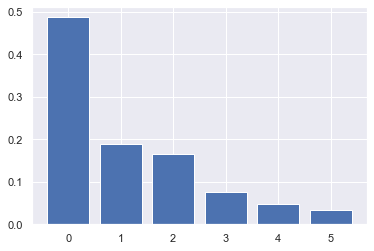

In [22]:
plt.bar(range(len(Mypca.explained_variance_ratio_)),Mypca.explained_variance_ratio_)
plt.show()

Avec 3 composantes, nous gardons 82% de nos données

## Ajustement du nombres de composantes

In [23]:
pca = decomposition.PCA(n_components=3)
pca.fit(X_scaled)

PCA(n_components=3)

## Représentation de la 1ére et 2ème composante

<Figure size 1080x720 with 0 Axes>

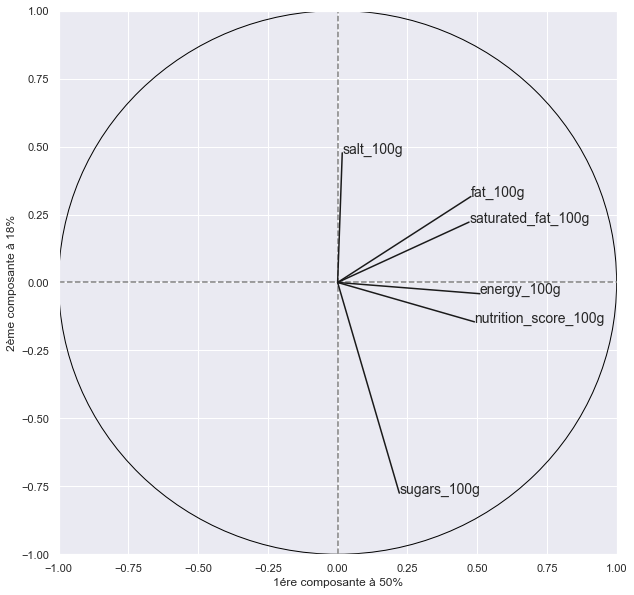

In [24]:
# projeter X sur les composantes principales
X_projected = pca.transform(X_scaled)

# afficher chaque observation
plt.figure(figsize=(15,10))

fig =  px.scatter(x=X_projected[:, 0], y=X_projected[:, 1],
    # colorer en utilisant la variable 'nutri-grade'
    color=result['nutrition_grade_fr'],color_discrete_sequence=['red', 'yellow', 'orange', 'green', 'lime'])
fig.update_layout(width=800, height=800, title = 'représentation de la 1ére et 2ème composante',
                  xaxis=dict(title='1ere composante à 50%'),
                  yaxis=dict(title='2eme composante à 18%')
                           )

fig.show()

# Cercle des corrélations
pcs = pca.components_

fig,ax = plt.subplots(figsize=(10,10))

# Afficher une ligne horizontale y=0
plt.plot([-1, 1], [0, 0], color='grey', ls='--')

# Afficher une ligne verticale x=0
plt.plot([0, 0], [-1, 1], color='grey', ls='--')

# Afficher un cercle de diametre 1
cercle = plt.Circle((0, 0),1, color='black', fill=False)
ax.add_artist(cercle)

# Afficher le nom des axes x et y
plt.xlabel('1ére composante à 50%')
plt.ylabel('2ème composante à 18%')

plt.xlim([-1, 1])
plt.ylim([-1, 1])

# Variable de l'acp
for i, (x, y) in enumerate(zip(pcs[0, :], pcs[1, :])):

    # Afficher un segment de l'origine au point (x, y)
    plt.plot([0, x], [0, y], color='k')
    # Afficher le nom (result.columns[i]) de la performance
    plt.text(x, y, resultValues.columns[i], fontsize='14')


plt.show()


## Représentation de la 1ére et 3ème composante

<Figure size 1080x720 with 0 Axes>

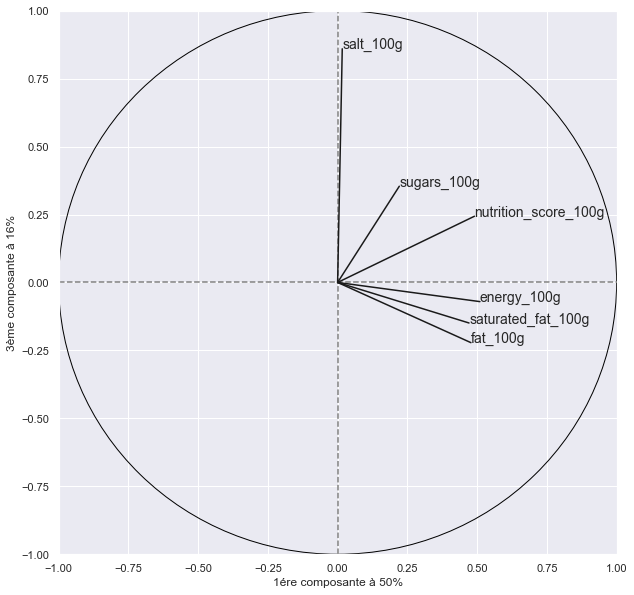

In [25]:
# projeter X sur les composantes principales
X_projected = pca.transform(X_scaled)

# afficher chaque observation
plt.figure(figsize=(15,10))

fig =  px.scatter(x=X_projected[:, 0], y=X_projected[:, 2],
    # colorer en utilisant la variable 'nutri-grade'
    color=result['nutrition_grade_fr'],color_discrete_sequence=['red', 'yellow', 'orange', 'green', 'lime'])
fig.update_layout(width=800, height=800, title = 'représentation de la 1ére et 3ème composante',
                  xaxis=dict(title='1ere composante à 50%'),
                  yaxis=dict(title='3ème composante à 16%')
                           )

fig.show()

# Cercle des corrélations
pcs = pca.components_

fig,ax = plt.subplots(figsize=(10,10))

# Afficher une ligne horizontale y=0
plt.plot([-1, 1], [0, 0], color='grey', ls='--')

# Afficher une ligne verticale x=0
plt.plot([0, 0], [-1, 1], color='grey', ls='--')

# Afficher un cercle de diametre 1
cercle = plt.Circle((0, 0),1, color='black', fill=False)
ax.add_artist(cercle)

# Afficher le nom des axes x et y
plt.xlabel('1ére composante à 50%')
plt.ylabel('3ème composante à 16%')

plt.xlim([-1, 1])
plt.ylim([-1, 1])

# Variable de l'acp
for i, (x, y) in enumerate(zip(pcs[0, :], pcs[2, :])):

    # Afficher un segment de l'origine au point (x, y)
    plt.plot([0, x], [0, y], color='k')
    # Afficher le nom (result.columns[i]) de la performance
    plt.text(x, y, resultValues.columns[i], fontsize='14')


plt.show()


## Représentation de la 2ème et 3ème composante

<Figure size 1080x720 with 0 Axes>

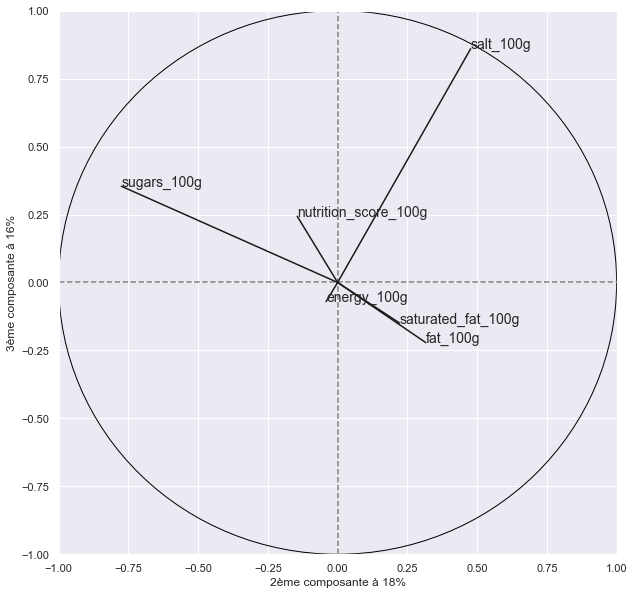

In [26]:
# projeter X sur les composantes principales
X_projected = pca.transform(X_scaled)

# afficher chaque observation
plt.figure(figsize=(15,10))

fig =  px.scatter(x=X_projected[:, 1], y=X_projected[:, 2],
    # colorer en utilisant la variable 'nutri-grade'
    color=result['nutrition_grade_fr'],color_discrete_sequence=['red', 'yellow', 'orange', 'green', 'lime'])
fig.update_layout(width=800, height=800, title = 'représentation de la 2ème et 3ème composante',
                  xaxis=dict(title='2ème composante à 18%'),
                  yaxis=dict(title='3ème composante à 16%')
                           )

fig.show()

# Cercle des corrélations
pcs = pca.components_

fig,ax = plt.subplots(figsize=(10,10))

# Afficher une ligne horizontale y=0
plt.plot([-1, 1], [0, 0], color='grey', ls='--')

# Afficher une ligne verticale x=0
plt.plot([0, 0], [-1, 1], color='grey', ls='--')

# Afficher un cercle de diametre 1
cercle = plt.Circle((0, 0),1, color='black', fill=False)
ax.add_artist(cercle)

# Afficher le nom des axes x et y
plt.xlabel('2ème composante à 18%')
plt.ylabel('3ème composante à 16%')

plt.xlim([-1, 1])
plt.ylim([-1, 1])

# Variable de l'acp
for i, (x, y) in enumerate(zip(pcs[1, :], pcs[2, :])):

    # Afficher un segment de l'origine au point (x, y)
    plt.plot([0, x], [0, y], color='k')
    # Afficher le nom (result.columns[i]) de la performance
    plt.text(x, y, resultValues.columns[i], fontsize='14')


plt.show()


Nous avons tendance à avoir des produits avec beaucoup de graisses, graisses saturées et de sel, dont le nutri-score est d ou e.

L'énergie et les graisses vont de pairs, donc les graisses apportent l'énergie et apporte un mauvais nutri-score.

Avec le nuage de points, nous pouvons voir aussi une quantité de produits plus élevé dont le nutri-score est d ou e

Avec l'appli, le consommateur sera averti du type de produits qu'il met dans son panier en pouvant vérifier ce qu'il achète.

## Colinéarité


VIF (Variance Inflation Factor) signifie Facteur d'Inflation de la Variance. Au cours de l'analyse de régression, VIF évalue si les facteurs sont corrélés les uns aux autres (multi-colinéarité), ce qui pourrait influencer les autres facteurs et réduire la fiabilité du modèle.Si un VIF est supérieur à 10, vous avez une multi-colinéarité élevée : la variation semblera plus grande et le facteur apparaîtra plus influent qu'il ne l'est. Si VIF est plus proche de 1, alors le modèle est beaucoup plus robuste, car les facteurs ne sont pas influencés par la corrélation avec d'autres facteurs.

In [27]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

X_variables = result[['energy_100g', 'salt_100g', 'sugars_100g', 'fat_100g', 'saturated_fat_100g', 'nutrition_score_100g']]

vif_data = pd.DataFrame()
vif_data["feature"] = X_variables.columns
vif_data["VIF"] = [variance_inflation_factor(X_variables.values, i)
for i in range(len(X_variables.columns))]
vif_data

,feature,VIF
0,energy_100g,5.851696
1,salt_100g,1.101848
2,sugars_100g,2.472894
3,fat_100g,4.427377
4,saturated_fat_100g,2.897573
5,nutrition_score_100g,4.710330


- Nous pouvons constater que les variables ne sont pas influencer les unes des autres.
- Cela prouve bien que les graisses sont une part importante dans notre alimentation.
- Le faite d'avoir une application pour informer le consommateur sur les teneurs nutritionnelles peut permettre de sensibiliser sur le 'mieux manger'

## Histogramme

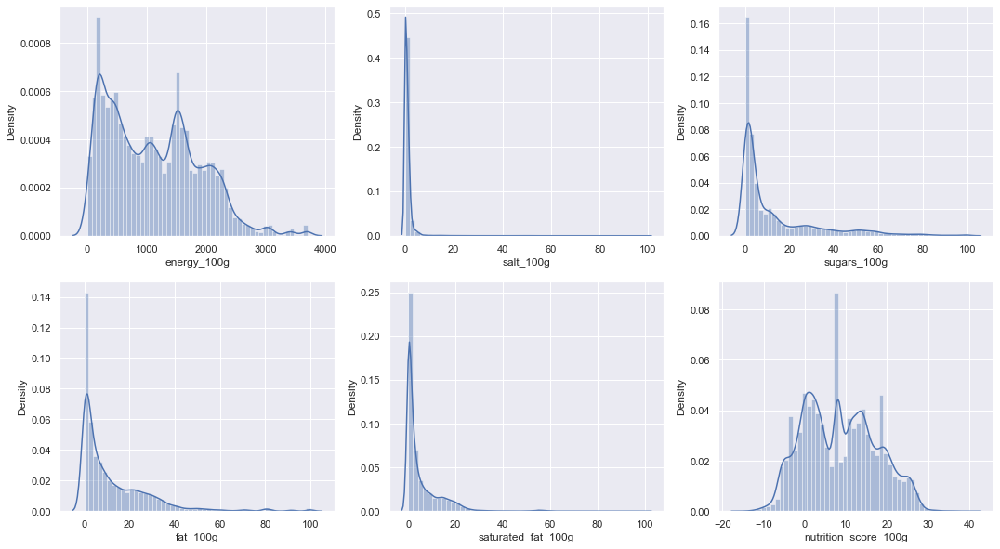

In [28]:
def plot_multiple_histograms(df, cols):
    num_plots = len(cols)
    num_cols = math.ceil(np.sqrt(num_plots))
    num_rows = math.ceil(num_plots/num_cols)
        
    fig, axs = plt.subplots(num_rows, num_cols, figsize=(18,10))
    
    for ind, col in enumerate(cols):
        i = math.floor(ind/num_cols)
        j = ind - i*num_cols
            
        if num_rows == 1:
            if num_cols == 1:
                sns.distplot(df[col], kde=True, ax=axs)
            else:
                sns.distplot(df[col], kde=True, ax=axs[j])
        else:
            sns.distplot(df[col], kde=True, ax=axs[i, j])

            
plot_multiple_histograms(result, ['energy_100g', 'salt_100g', 'sugars_100g', 'fat_100g', 'saturated_fat_100g', 'nutrition_score_100g'])